### Étude de cas 1

Justin Bédard, 11149923

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import statsmodels.api as sm
from scipy.stats import norm
import scipy.stats as stats
from statsmodels.tsa.ar_model import AutoReg
from sklearn.metrics import mean_squared_error

In [9]:
RH = pd.read_csv('data/RH_data.csv', parse_dates=['date'])
stock = pd.read_csv('data/stock_data.csv', parse_dates=['DlyCalDt'])
snp = pd.read_csv('data/snp500.csv', parse_dates=['caldt'])

stock.rename(columns={"DlyCalDt": "date",},inplace=True,)
snp.rename(columns={"caldt": "date",},inplace=True,)
RH.rename(columns={"tic": "Ticker",},inplace=True,)

df = pd.merge(RH, stock, how="inner", on=["date", "Ticker"])
#df = pd.merge(df, snp, how="inner", on=["date"])

df['holdingtotal'] = df.groupby('date')['users_holding'].transform('sum')
df["percentage"]=df["users_holding"]/df["holdingtotal"]
df["GS"]=df["percentage"]*df["DlyRet"]

df = df.dropna(subset=['GS'])
df= df[df['DlyVol'] != 0]


somme_rendements_par_jour = df.groupby('date')['GS'].sum()


# Calcul du total des holdings par jour dans Robinhood
#merged_data['total_holding_per_day'] = merged_data.groupby('DlyCalDt')['users_holding'].transform('sum')

# Calcul des poids pour chaque action dans le portefeuille Robinhood
#merged_data['weight'] = merged_data['users_holding'] / merged_data['total_holding_per_day']

# Calculer le rendement pondéré pour chaque action
#merged_data['weighted_return'] = merged_data['weight'] * merged_data['DlyRet']

# Calculer le rendement total du portefeuille pour chaque jour
#portfolio_returns = merged_data.groupby('DlyCalDt')['weighted_return'].sum()


C:\Users\bedar\AppData\Local\Temp\ipykernel_31216\1218959439.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  RH = pd.read_csv('data/RH_data.csv', parse_dates=['date'])
C:\Users\bedar\AppData\Local\Temp\ipykernel_31216\1218959439.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  stock = pd.read_csv('data/stock_data.csv', parse_dates=['DlyCalDt'])


count    397.000000
mean       0.001363
std        0.022473
min       -0.118426
25%       -0.006765
50%        0.001790
75%        0.010136
max        0.104289
Name: GS, dtype: float64
count    420.000000
mean       0.001027
std        0.017005
min       -0.118970
25%       -0.003468
50%        0.001678
75%        0.007051
max        0.093205
Name: vwretd, dtype: float64


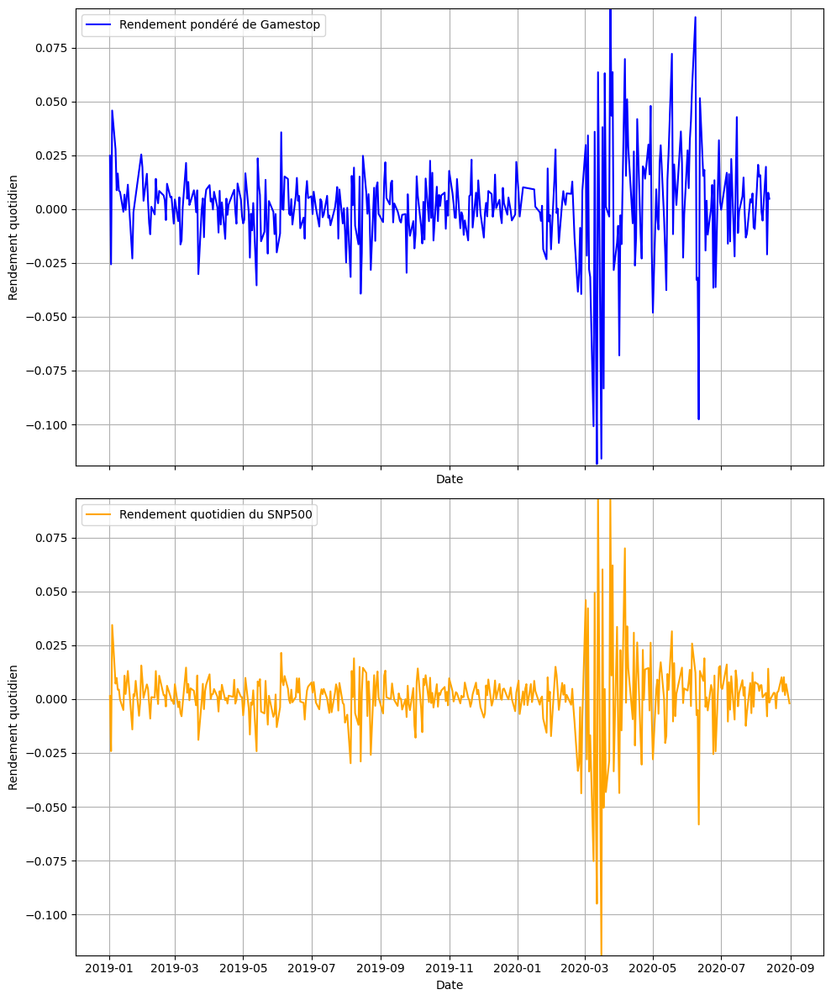

In [ ]:
#print(df.info)
#tickers_uniques = df['Ticker'].unique()
#print(tickers_uniques)

#stats = df.groupby('date')['GS'].describe()
stats = somme_rendements_par_jour .describe()
# Print les statistiques descriptives
#print(df.describe())
print(stats)

#statssnp=snp.groupby('date')['vwretd'].describe()
statssnp=snp['vwretd'].describe()
print(statssnp)

# Visualiser les données

# Liste des tickers à visualiser

# Appliquer le style par défaut
plt.style.use('default')

# Calculer les limites des rendements pour une échelle uniforme
#y_min = df['GS'].min()
#y_max = df['GS'].max()
y_min2 = snp['vwretd'].min()
y_max2 = snp['vwretd'].max()

# Créer une figure avec 2 sous-graphiques (subplots)
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 12), sharex=True)

# Couleurs pour chaque ticker


# Tracer les rendements pour chaque ticker avec la même échelle
axes[0].plot(somme_rendements_par_jour, label='Rendement pondéré de Gamestop', color='blue')
axes[0].set_ylabel('Rendement quotidien')
axes[0].set_xlabel('Date')
axes[0].set_ylim(y_min2, y_max2)  # Appliquer la même échelle pour le graphique du marché
axes[0].legend()
axes[0].grid(True)

# Tracer la courbe des rendements pour market portfolio
axes[1].plot(snp['date'].unique(), snp['vwretd'], label='Rendement quotidien du SNP500', color='orange')
axes[1].set_ylabel('Rendement quotidien')
axes[1].set_xlabel('Date')
axes[1].set_ylim(y_min2, y_max2)  # Appliquer la même échelle pour le graphique du marché
axes[1].legend()
axes[1].grid(True)

# Ajuster l'espacement entre les sous-graphiques
plt.tight_layout()

# Afficher le graphique
plt.show()

In [16]:
def calculate_var_es(returns, alpha):
    """
    Calcule la VaR et l'ES pour un niveau de confiance alpha donné.

    Paramètres:
    - returns : array 1-D des rendements (doit être une série de valeurs numériques)
    - alpha : float, niveau de confiance pour la VaR et l'ES, entre 0 et 1

    Retourne:
    - var_alpha : Valeur à Risque au niveau de confiance alpha
    - es_alpha : Expected Shortfall au niveau de confiance alpha
    """
    # Vérification des limites de alpha
    if alpha <= 0 or alpha >= 1:
        raise ValueError("Le paramètre alpha doit être entre 0 et 1 (exclu).")

    # Calculer la VaR comme le quantile inférieur (perte maximale au niveau de confiance)
    var = np.percentile(returns, alpha * 100)
    
    # Calculer l'Expected Shortfall (ES) comme la moyenne des pertes inférieures à la VaR
    es = returns[returns <= var].mean()
    
    return var, es

alpha = 0.05  # Niveau de confiance de 95%

var, es = calculate_var_es(somme_rendements_par_jour , alpha)
     
print(f"RH VaR (niveau {alpha*100}%): {var:.4f}, Expected Shortfall (niveau {alpha*100}%): {es:.4f}")

alpha = 0.01  # Niveau de confiance de 95%

var, es = calculate_var_es(somme_rendements_par_jour , alpha)
     
print(f"RH VaR (niveau {alpha*100}%): {var:.4f}, Expected Shortfall (niveau {alpha*100}%): {es:.4f}")

alpha = 0.05  # Niveau de confiance de 95%

var, es = calculate_var_es(snp['vwretd'] , alpha)
     
print(f"SNP500 VaR (niveau {alpha*100}%): {var:.4f}, Expected Shortfall (niveau {alpha*100}%): {es:.4f}")

alpha = 0.01  # Niveau de confiance de 95%

var, es = calculate_var_es(snp['vwretd'] , alpha)
     
print(f"SNP500 VaR (niveau {alpha*100}%): {var:.4f}, Expected Shortfall (niveau {alpha*100}%): {es:.4f}")

RH VaR (niveau 5.0%): -0.0302, Expected Shortfall (niveau 5.0%): -0.0553
RH VaR (niveau 1.0%): -0.0839, Expected Shortfall (niveau 1.0%): -0.1082
SNP500 VaR (niveau 5.0%): -0.0243, Expected Shortfall (niveau 5.0%): -0.0445
SNP500 VaR (niveau 1.0%): -0.0501, Expected Shortfall (niveau 1.0%): -0.0796


In [ ]:
# Initialisation des listes de prévisions et de valeurs réelles
forecast_values = []
true_values = []

df2 = df[['GS','date']]
df2 = df2.set_index('date')


# Boucle de prévisions glissantes
p = 3  # Choisissez l'ordre p du modèle AR
window = 1000  # Par exemple, nous commençons la prévision après 100 points

for i in range(window, len(df2)):
    train, test = df2['GS'][:i], df2['GS'][i]
    model = AutoReg(train, lags=p).fit()
    forecast = model.predict(start=len(train), end=len(train))[0]
    forecast_values.append(forecast)
    true_values.append(test)

# Calculer les statistiques sommaires sur les prévisions
forecast_series = pd.Series(forecast_values)
mse = mean_squared_error(true_values, forecast_values)
print("MSE des prévisions :", mse)

C:\Users\bedar\AppData\Local\Temp\ipykernel_3360\2790427776.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  train, test = df2['GS'][:i], df2['GS'][i]
c:\Users\bedar\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\bedar\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\bedar\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py: